In [31]:
import os, sys, shutil, time, os.path as osp, logging, numpy as np
from pathlib import Path
import matplotlib.pyplot as plt, cycler
import matplotlib
import tqdm
import pandas as pd

In [32]:
INPUT_PATH = Path('../../data/single_tau/output')
files = [str(p) for p in INPUT_PATH.glob('data*.pkl')]

In [33]:
class Event():
    @classmethod
    def from_file(cls, f):
        data = pd.read_pickle(f)
        X = data.loc[:, ['x', 'y', 'z', 'E', 't']]
        target = data.loc[:, 'target']
        prediction = data.loc[:, 'prediction']
        return cls(
            X = X, target = target,
            prediction = prediction
            )
    
    def __init__(self, X, target, prediction):
        self.X = X
        self.target = target
        self.prediction = prediction
        self.num_classes = 4
        self.num_hits = self.X.shape[0]
        
class EventFactory():
    def __init__(self, files, max_events=None):
        self.files = files
        self.max_events = max_events
        self.do_tqdm = False
        
    def __iter__(self):
        if self.do_tqdm:
            total = len(self.files)
            if not(self.max_events is None) and self.max_events < total:
                total = self.max_events
            iterator = tqdm(enumerate(self.files), total=total)
        else:
            iterator = enumerate(self.files)
        
        for i, f in iterator:
            if not(self.max_events is None) and i >= self.max_events: break
            yield Event.from_file(f)                

In [34]:
class PlotEventDisplay():
    def __init__(self, event):
        self.event = event

    def plot_output(self, label, title=None, savefig=None):
        fig, (ax0,ax1) = plt.subplots(1, 2, figsize=(20,12))        
        fig.set_facecolor('white')
        if title: fig.suptitle(title, fontsize=28)
        
        e_max = np.max(self.event.X.loc[:,'E'].values)
        e_normed = 100.*np.tanh(self.event.X.loc[:,'E'].values/e_max)
        
        color_cycler = cycler.cycler(color=['b', 'r', 'g', 'y', 'm', 'c'])()
        
        for i_cat in range(self.event.num_classes):
            color = next(color_cycler)['color']
            X = self.event.X.loc[label == i_cat]
            ax0.scatter(X.loc[:,'x'], X.loc[:,'z'], s=(e_normed), c=color)
            ax1.scatter(X.loc[:,'y'], X.loc[:,'z'], s=(e_normed), c=color)

        ax0.legend(['Noise', 'HAD', 'EM', 'MIP'], prop={'size': 24})
        fontsize = 24
        ax0.set_xlabel('x [cm]', fontsize=fontsize)
        ax0.set_ylabel('layer', fontsize=fontsize)
        ax1.set_xlabel('y [cm]', fontsize=fontsize)
        ax1.set_ylabel('layer', fontsize=fontsize)
        ax0.tick_params(axis='both', which='major', labelsize=20)
        ax1.tick_params(axis='both', which='major', labelsize=20)
        if savefig:
            fig.savefig(savefig)
            plt.close(fig)

    def plot_prediction(self, savefig=None):
        return self.plot_output(self.event.prediction, 'Prediction', savefig)
    
    def plot_truth(self, savefig=None):
        return self.plot_output(self.event.target, 'Truth', savefig)

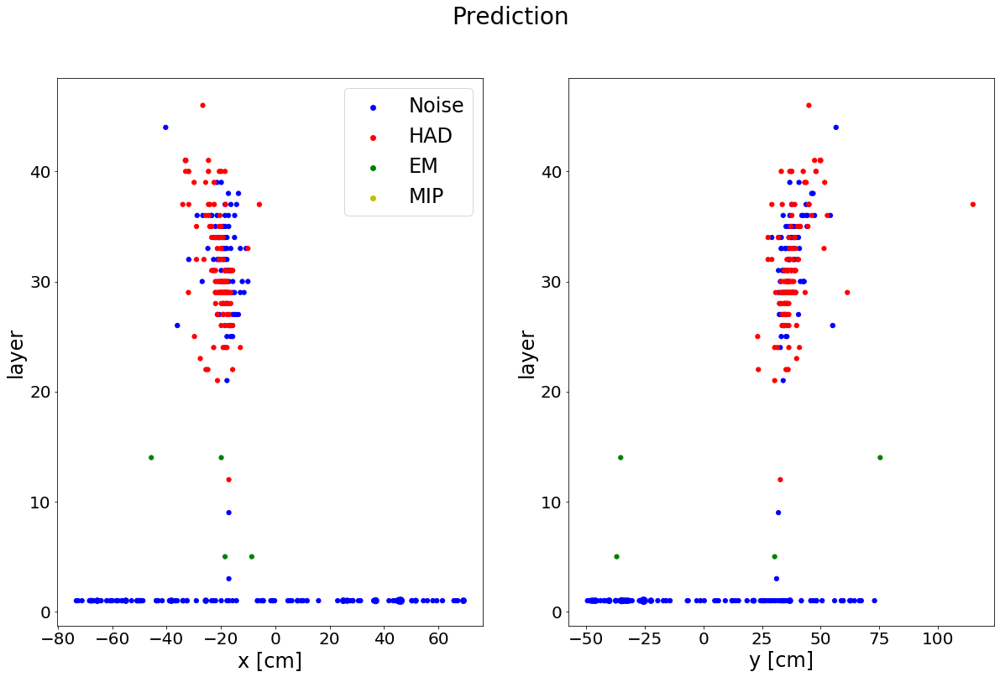

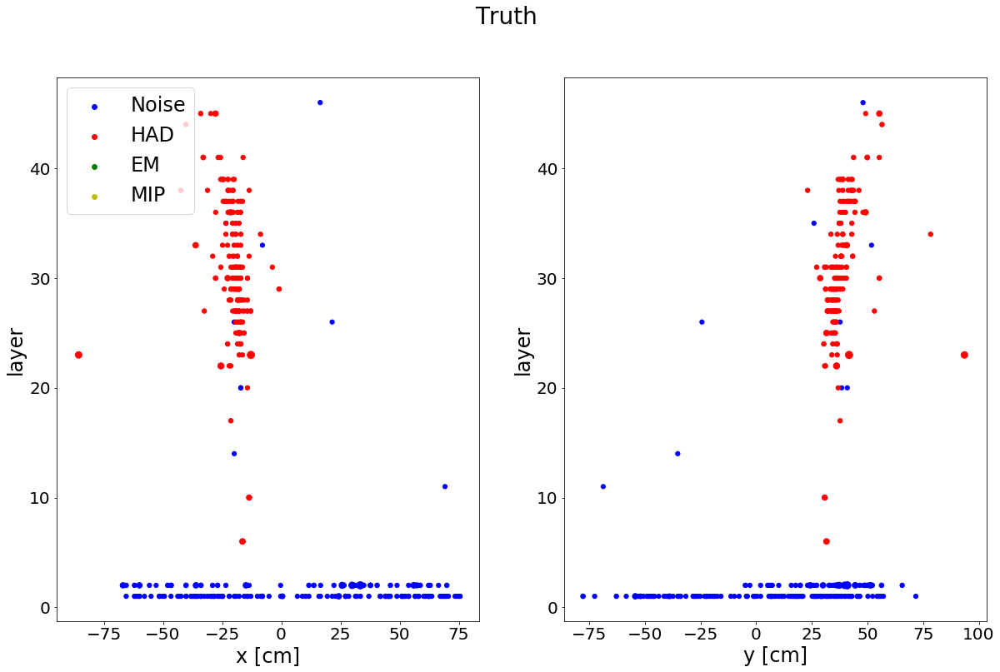

In [35]:
for event in EventFactory(files):
    plot = PlotEventDisplay(event)
    break
    
plot.plot_prediction()
plot.plot_truth()

In [36]:
if not osp.isdir('eventdisplays'): os.makedirs('eventdisplays')

backend_ =  matplotlib.get_backend() 
matplotlib.use("Agg")  # Prevent showing stuff

for i_event, event in enumerate(EventFactory(files, max_events=100)):
    plot = PlotEventDisplay(event)
    plot.plot_prediction('eventdisplays/{0:03d}_pred.png'.format(i_event))
    plot.plot_truth('eventdisplays/{0:03d}_truth.png'.format(i_event))

matplotlib.use(backend_) # Reset backend

NameError: name 'valid_loader' is not defined

In [ ]:
from sklearn.metrics import confusion_matrix
from tqdm.notebook import tqdm

class PlotStatistics():
    def __init__(self, files):
        self.files = files
        self.num_classes = 4
        # self.n_events = 100
        self.n_events = None
        
    def events(self):
        return EventFactory(self.files, self.n_events)
                
    def single_confusion_matrix(self, event):
        conf_mat = confusion_matrix(
            event.target.values, event.output.values,
            labels = np.arange(self.num_classes),
            # normalize = 'true'
            )
        # If there are zero events of a category, sklearn puts a zero
        # on the diagonal. That screws up averaging.
        # for i_cat in range(self.num_classes):
        #     if conf_mat[i_cat][i_cat] == 0.0:
        #         conf_mat[i_cat][i_cat] = 1.0
        return conf_mat
    
    def average_confusion_matrix(self):
        total_confusion_matrix = np.zeros((self.num_classes, self.num_classes))
        for event in self.events():
            total_confusion_matrix = np.add(
                total_confusion_matrix,
                self.single_confusion_matrix(event)
                )
        sums = total_confusion_matrix.sum(axis=0)
        return total_confusion_matrix / sums
    
    def _energy_collection_perevent(self, event, i_cat):
        pred_energy = event.X.loc[event.output == i_cat, 'E'].sum()
        true_energy = event.X.loc[event.target == i_cat, 'E'].sum()
        return pred_energy/true_energy if true_energy > 0. else -1
    
    def get_energy_collection(self):
        energy_collection_per_cat = [ [] for i_cat in range(self.num_classes) ]
        for event in self.events():
            for i_cat in range(self.num_classes):
                energy_collection = self._energy_collection_perevent(event, i_cat)
                if energy_collection != -1:
                    energy_collection_per_cat[i_cat].append(energy_collection)
        return energy_collection_per_cat

    def plot_energy_collection_hist(self, energy_collection_per_cat=None, savefig=None):
        fig, axs = plt.subplots(2, 2, figsize=(12,12))
        color_cycler = cycler.cycler(color=['b', 'r', 'g', 'y', 'm', 'c'])()
        labels = [ 'Noise', 'HAD', 'EM', 'MIP' ]
        
        if energy_collection_per_cat is None:
            energy_collection_per_cat = self.get_energy_collection()
        
        for i_cat, ax in zip(range(self.num_classes), axs.ravel()):
            ax.hist(
                energy_collection_per_cat[i_cat],
                bins = np.linspace(0.5, 1.5, 50),
                histtype = u'step', label = labels[i_cat],
                **next(color_cycler)
                )
            ax.legend(fontsize=14)
            ax.set_ylabel('Count', fontsize=14)
            ax.set_xlabel('E_pred / E_true', fontsize=14)
            
        if savefig: fig.savefig(savefig, bbox_inches='tight')

plot = PlotStatistics(valid_loader)

In [ ]:
conf_mat = plot.average_confusion_matrix()

In [ ]:
# plot.n_events = 10
plot.n_events = None
energy_collection_per_cat = plot.get_energy_collection()

In [ ]:
plot.plot_energy_collection_hist(energy_collection_per_cat, savefig='energycollection.pdf')